## Chapter 2: Derivatives and Automatic Differentiation

#  2.2  Derivatives at a point and the Numerical Differentiator

In the previous Section we described in words and pictures what the derivative at a point is - in this Section we get more formal and describe these ideas mathematically and programatically.  We will start our discussion with functions that take in only one input like the familiar sinusoidal function 

\begin{equation}
g(w) = \text{sin}(w)
\end{equation}

which takes in the single input $w$ (we generalize afterwards to functions that take in more than one input). 

Remember what we said in words / pictures previously about the derivative of a function at a point: the derivative at a point defines a line that is always tangent to a function, encodes its steepness at that point, and generally matches the underlying function near the point locally.  In other words: the derivative at a point is the slope of the tangent line there.

> The derivative at a point is the slope of the tangent line at that point.

How can we more formally describe such a tangent line and derivative? 

In [1]:
# This code cell will not be shown in the HTML version of this notebook
#imports from custom library
import sys
sys.path.append('../../')
from mlrefined_libraries import calculus_library as calclib
from mlrefined_libraries import basics_library as baslib

# import autograd
import autograd.numpy as np
import matplotlib.pyplot as plt

%load_ext autoreload
%autoreload 2

## 2.2.1 Secant lines

In the image below we show a picture of the sinusoid in the left panel, where we have plugged the input point $w^0 = 0$ into the sinusoid and highlighted <span style="color:#32cd32"> the corresponding point $(0, \text{sin}(0))$ in green </span>.  In the middle panel we plot another point on the curve - with input $w^1 = -2.6$ <span style="color:blue"> the point $(-2.6, \text{sin}(-2.6) ) $ in blue </span>, and <span style="color:red"> the *secant line* in red </span> formed by connecting <span style="color:blue"> $(-2.6, \text{sin}(-2.6) ) $ </span> and <span style="color:#32cd32"> $(0, \text{sin}(0))$ </span>.  Finally in the right panel we show <span style="color:#32cd32"> the tangent line at $w = 0$ in lime green. </span>  The <span style="color:gray"> gray vertical dashed lines </span> in the middle panel are there for visualization purposes only.

<p><img src= '../../mlrefined_images/calculus_images/tangent_secant.png' width="100%" height="100%"/></p>

A *secant line* is just a line formed by taking any two points on a function - like our sinusoid - and connecting them with a straight line.  On the other hand, while a tangent line can cross through several points of a function it is explicitly defined using only a single point.  So in short - a secant line is defined by two points, a tangent line by just one.

The equation of any secant line is easy to derive - since all we need is the slope and any point on the line to define it - and the slope of a line can be found using any two points on it (like the two points we used to define the secant to begin with).

The slope - the line's 'steepness' or 'rise over run' - is the ratio of change in output $g(w)$ over the change in input $w$.  If we used two generic inputs $w^0$ and $w^1$ - above we chose $w^0 = 0$ and $w^1 = -2.6$ - we can write out the slope of a secant line generally as 

\begin{equation}
\text{slope of a secant line} = \frac{g(w^1) - g(w^0)}{w^1 - w^0}
\end{equation}

Now using the point-slope form of a line we can directly write out the equation of a secant using the slope above and either of the two points we used to define the secant to begin with - using $(w^0, g(w^0))$ we then have the equation of a secant line $h(w)$ is

\begin{equation}
h(w)  = g(w^0) +  \frac{g(w^1) - g(w^0)}{w^1 - w^0}(w - w^0)
\end{equation}

If we think about our <span style="color:#32cd32"> green point </span> at $w^0 = 0$ as fixed, then the tangent line at this point can be thought of as the line we get when we shift the <span style="color:blue"> blue point </span> very close - infinitely close actually - to the green one.  

#### <span style="color:#a50e3e;">Example 1. </span> Secant line computation

Taking $w^0 = 0$ and $w^1 = -2.6$ the equation of the secant line connecting $(w^0,\text{sin}(w^0))$ and $(w^1,\text{sin}(w^1))$ on the sinusoid is given as

\begin{equation}
h(w)  = \text{sin}(0) +  \frac{\text{sin}(-2.6) - \text{sin}(0)}{-2.6 - 0}(w - 0)
\end{equation}

Since $\text{sin}(0) = 0$ and $\text{sin}(-2.6) \approx -0.5155$ we can write this as 

\begin{equation}
h(w)  =  \frac{0.5155}{2.6}w
\end{equation}

## 2.2.2 From secant to tangent line

Below we show a slider-based animation widget that illustrates precisely this idea.  As you shift the slider from left to right the <span style="color:blue"> blue point </span> - along with the <span style="color:red"> red secant line </span> that passes through it and the <span style="color:#32cd32"> green point </span> - moves closer and closer to our fixed point.  Finally - when the two points lie right on top of each other - the <span style="color:red"> secant line </span> becomes the <span style="color:#32cd32"> green tangent line </span> at our fixed point.


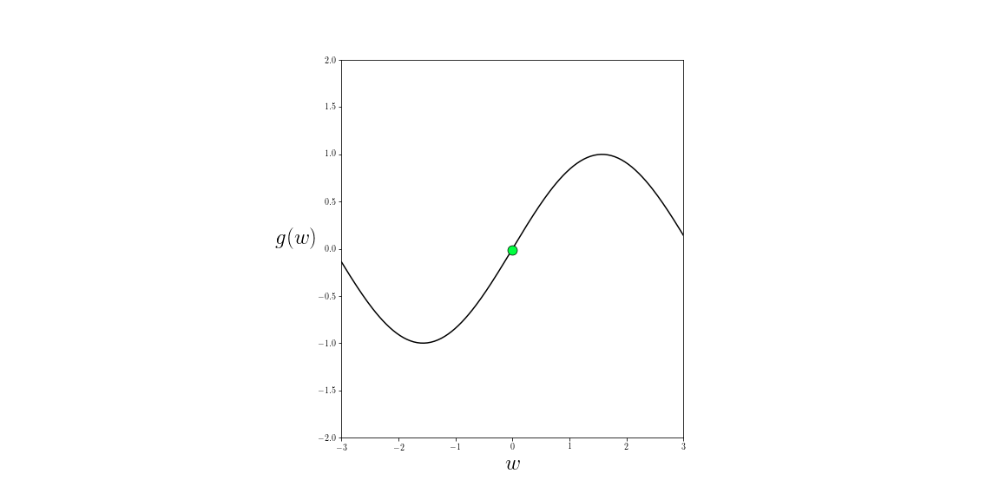
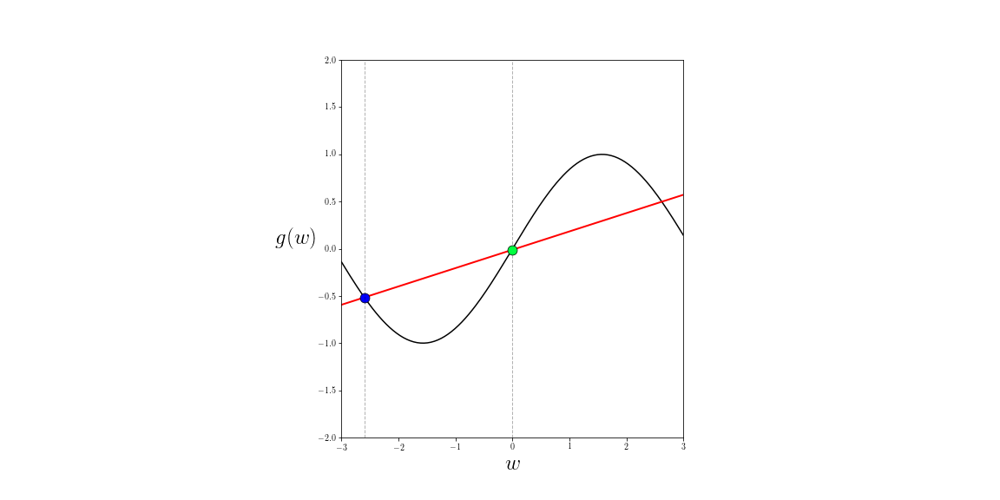
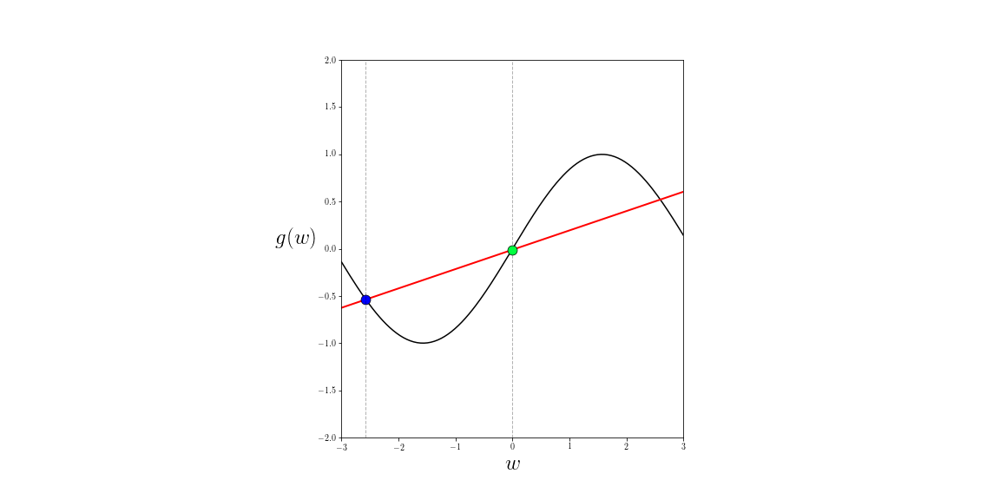
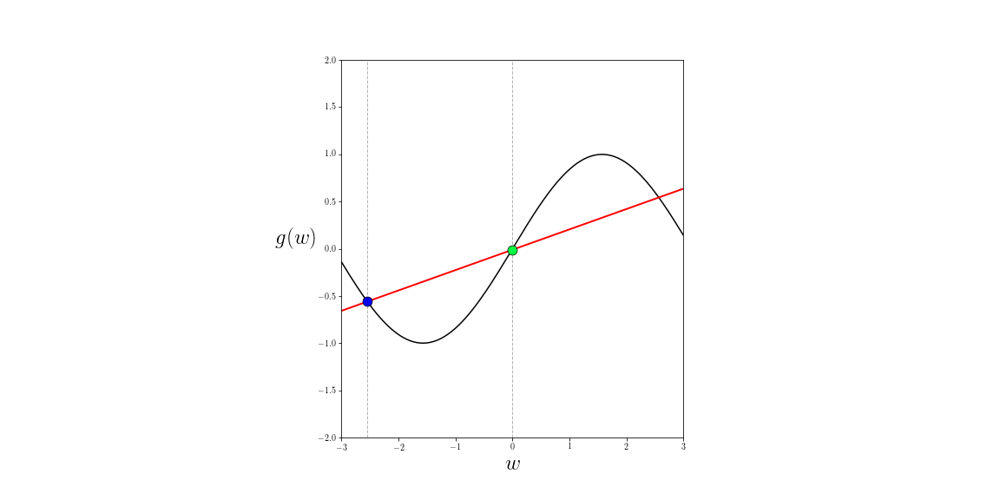
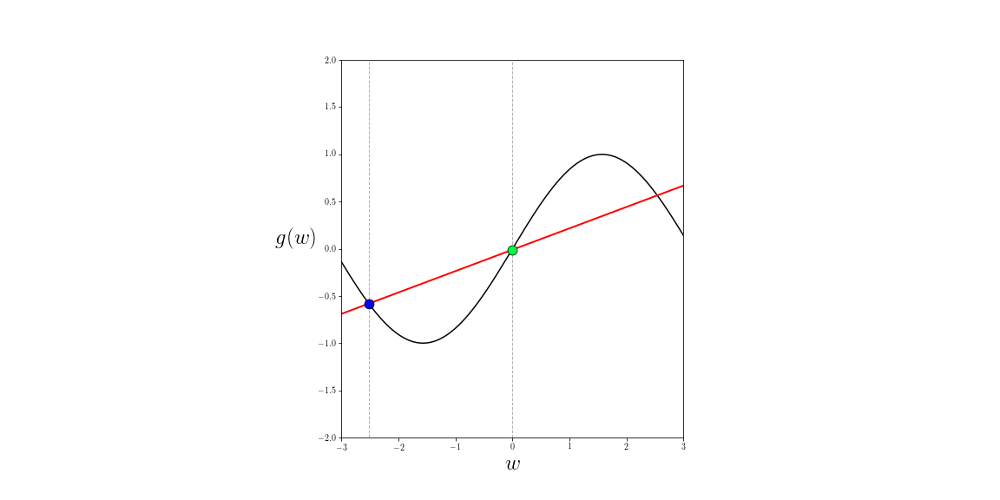
...
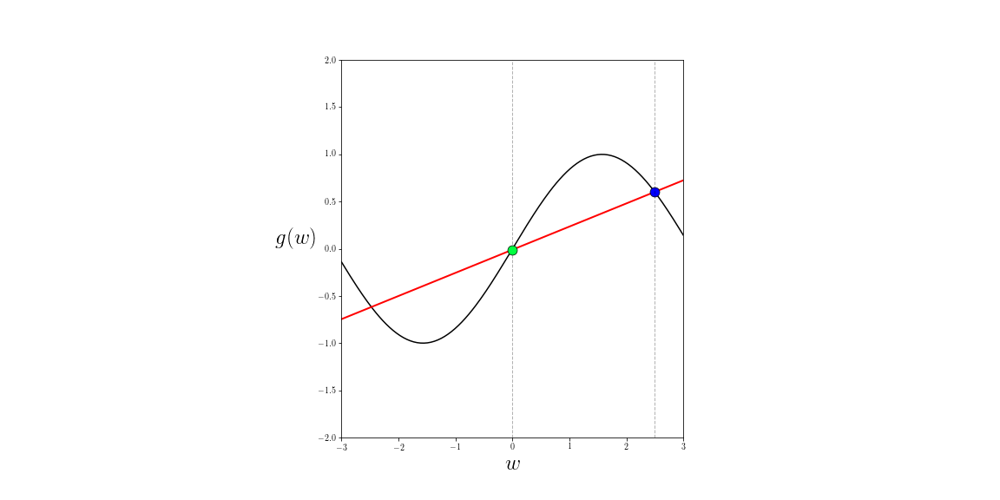
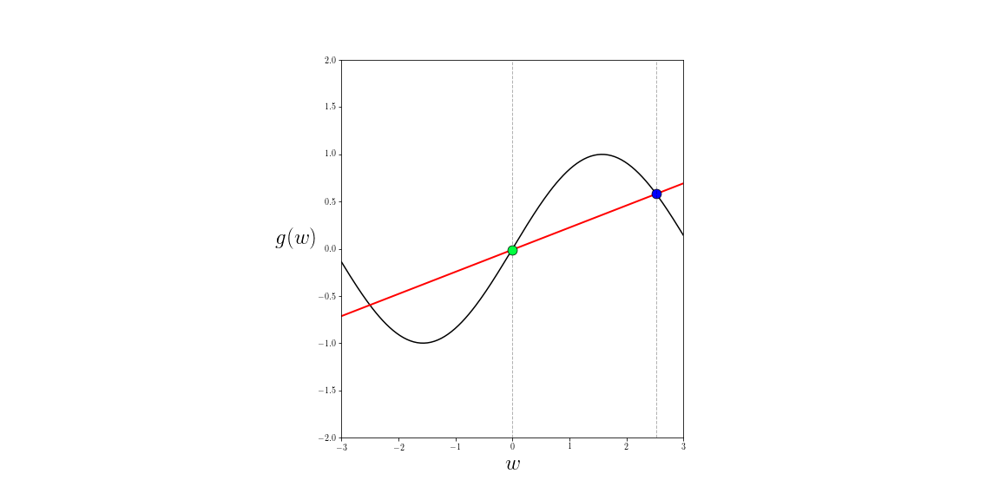
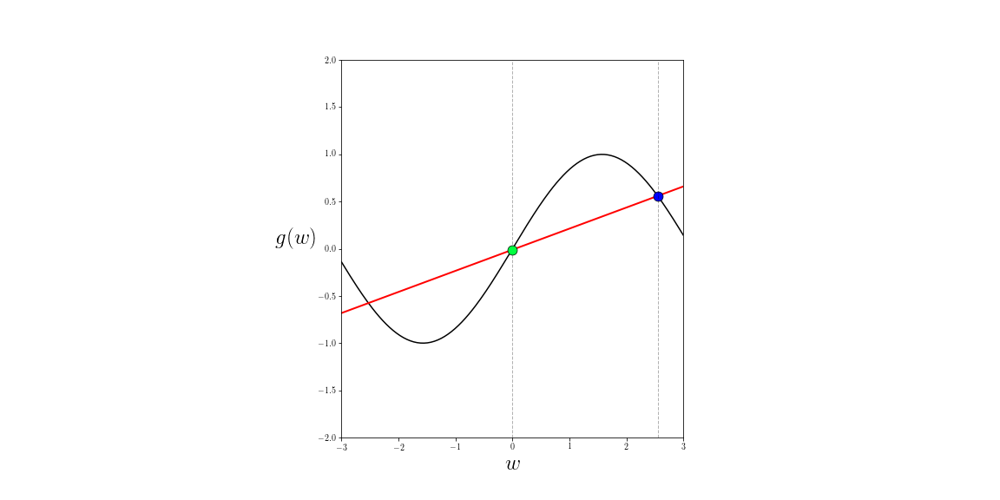
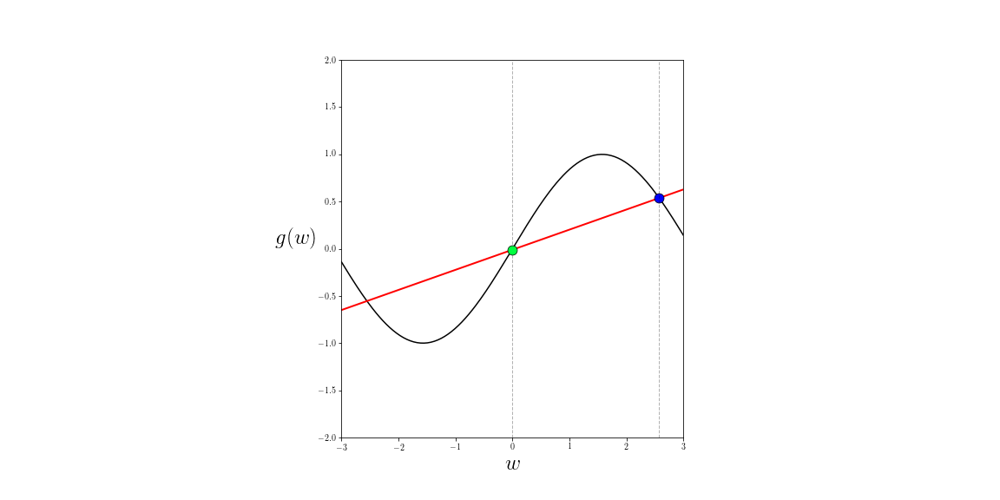
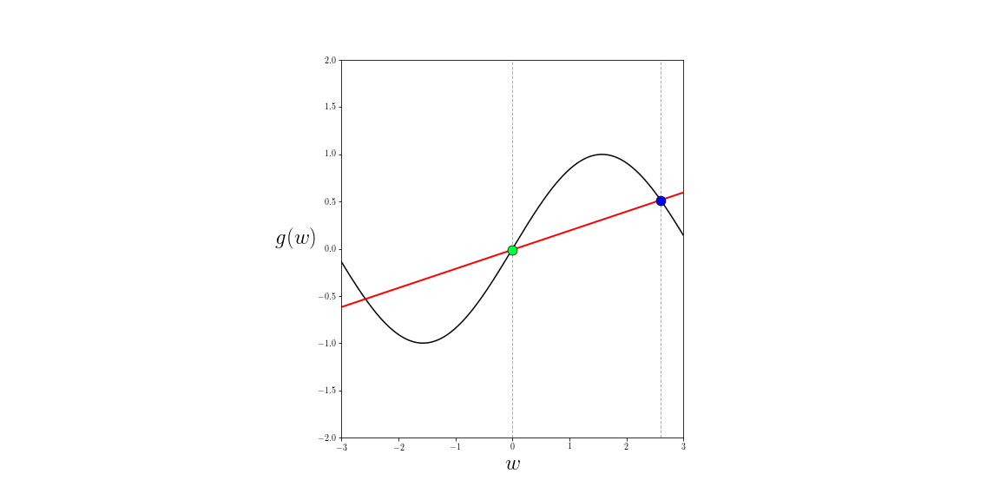

In [2]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.sin(w)

# create an instance of the visualizer with this function
st = calclib.secant_to_tangent.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(w_init = 0, num_frames = 200)

In sliding back and forth, notice how it does not matter if we start from the left of our fixed point and move right towards it, or start to the right of the fixed point and move left towards it: either way the secant line *gradually* becomes tangent to the curve at $w^0 = 0$.  There is no big 'jump' in the slope of the line if we wiggle the slider ever so slightly to the left or right of the fixed point - the slopes of the nearby secant lines are very very similar to that of the tangent. 

When we can do this - come at a fixed point from either the left or the right and the secant line becomes tangent smoothly from either direction with no jump in the value of the slope - we say that a function has a *derivative* at this point, or likewise say that it is *differentiable* at the point.  

> If the slope of the secant line varies gradually - with no visible jumps - from both the left and right of a fixed point on a function, we say that a function has a *derivative* at this point, or likewise say that it is *differentiable* at the point.  A function that has a derivative at every point is called differentiable.

#### <span style="color:#a50e3e;">Example 2. </span>  The hyperbolic tangent, squared

Many functions like our sinusoid, other trigonometric functions, and polynomials are differentiable at every point - or just *differentiable* for short.  In the Jupyter notebook version of this Section you can tinker around with the previous Python cell - pick another fixed point! - and see this for yourself.  You can also tinker around with the function - for example in the next cell we show - using the same slider mechanism - that the function

\begin{equation}
g(w) = \text{tanh}(w)^2
\end{equation}

has a derivative at the point $w^0$ = 1.


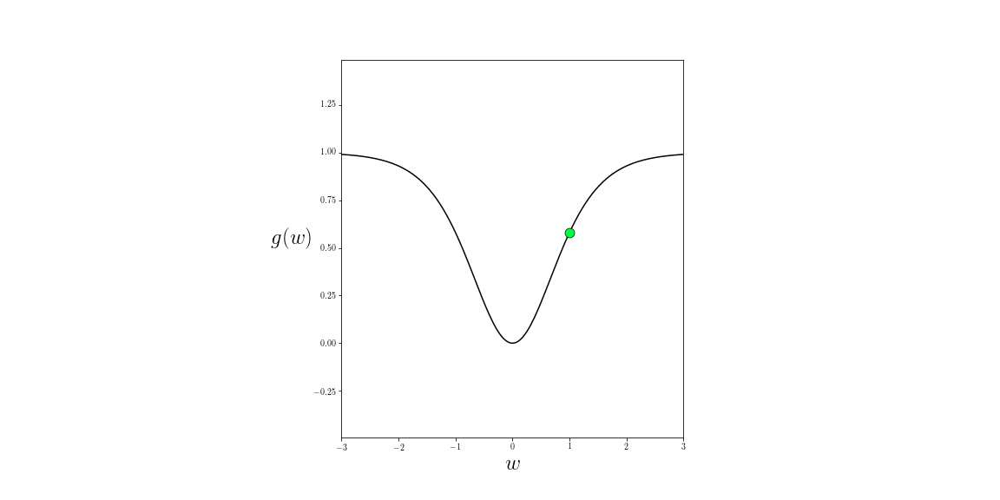
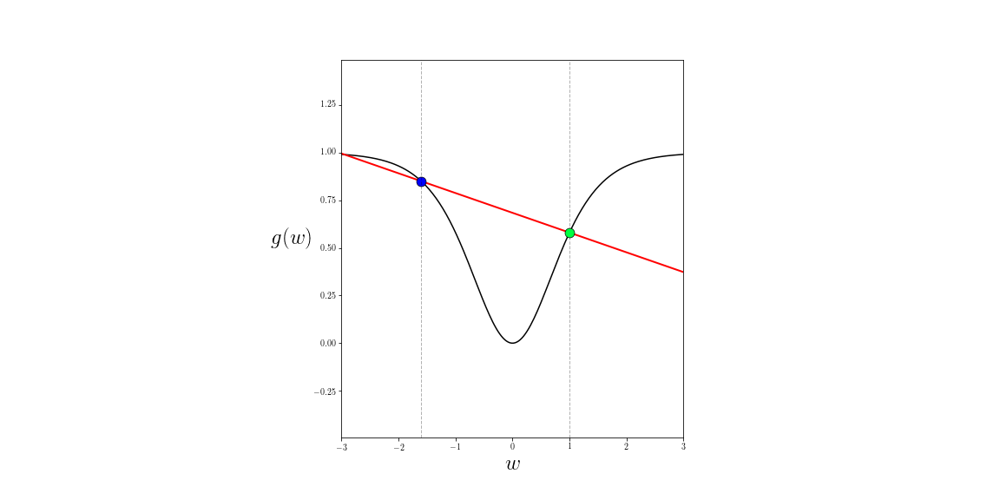
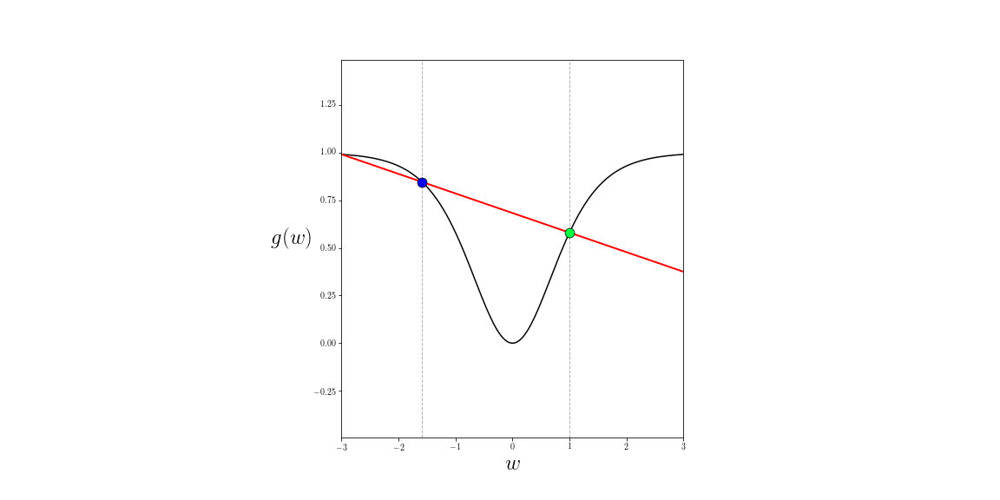
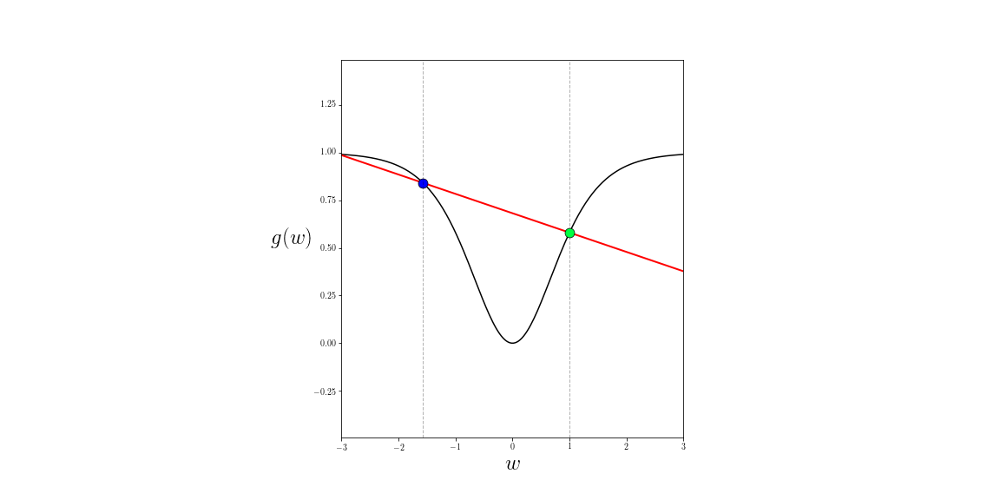
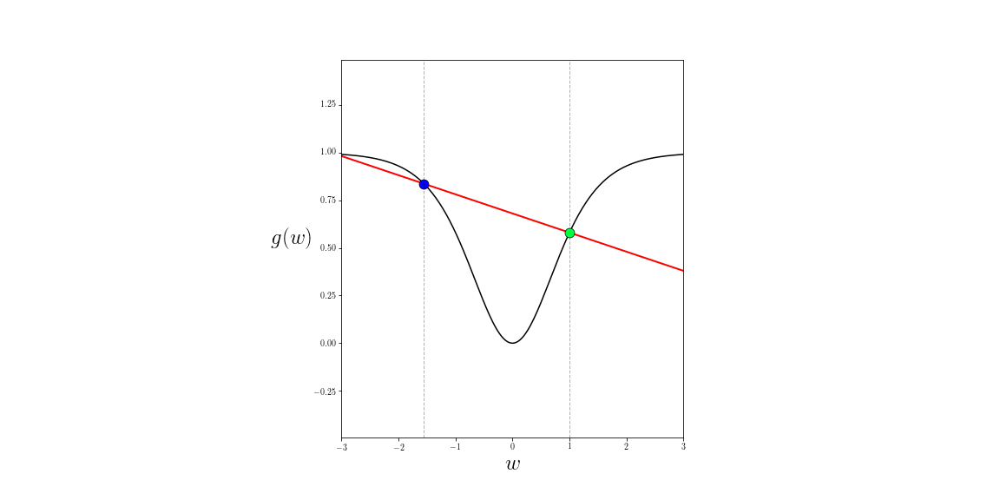
...
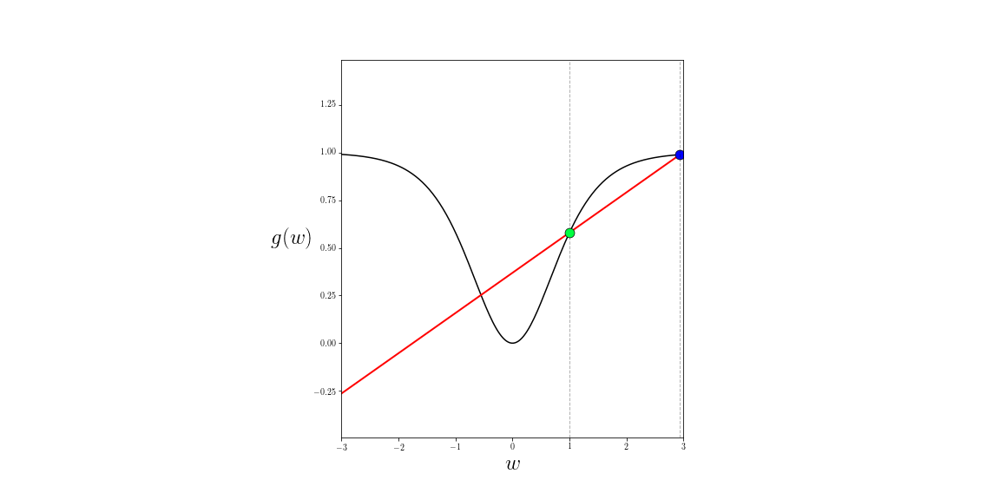
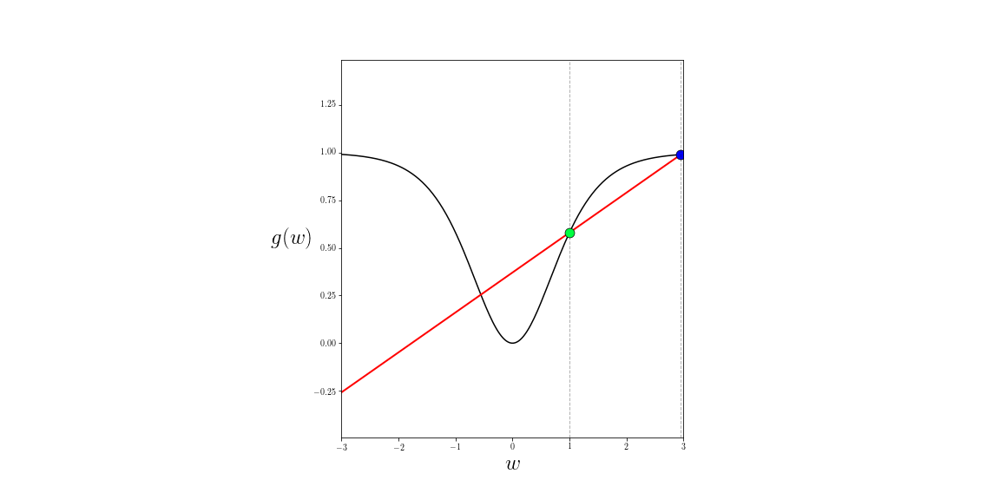
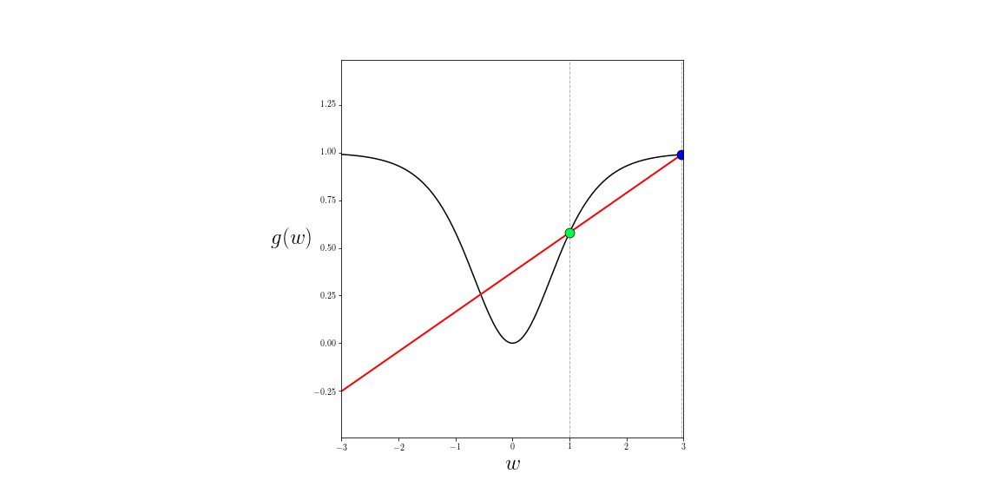
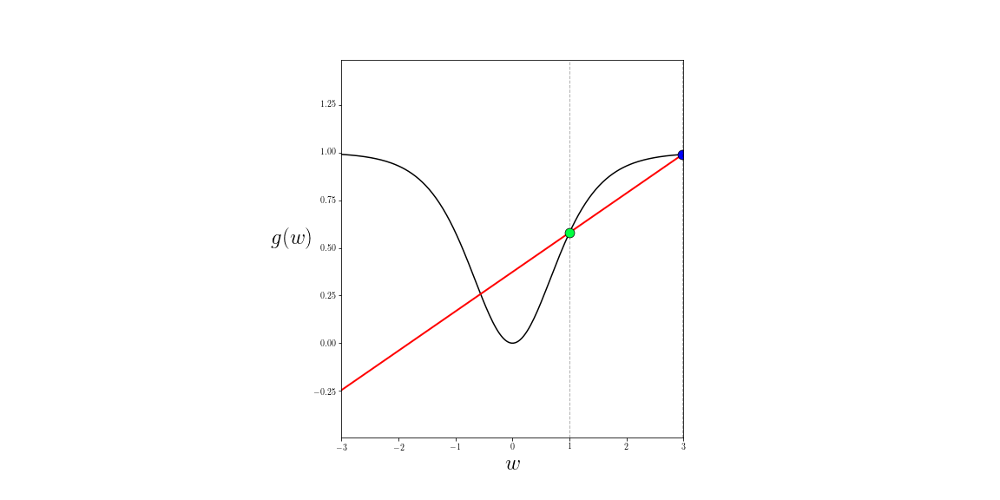
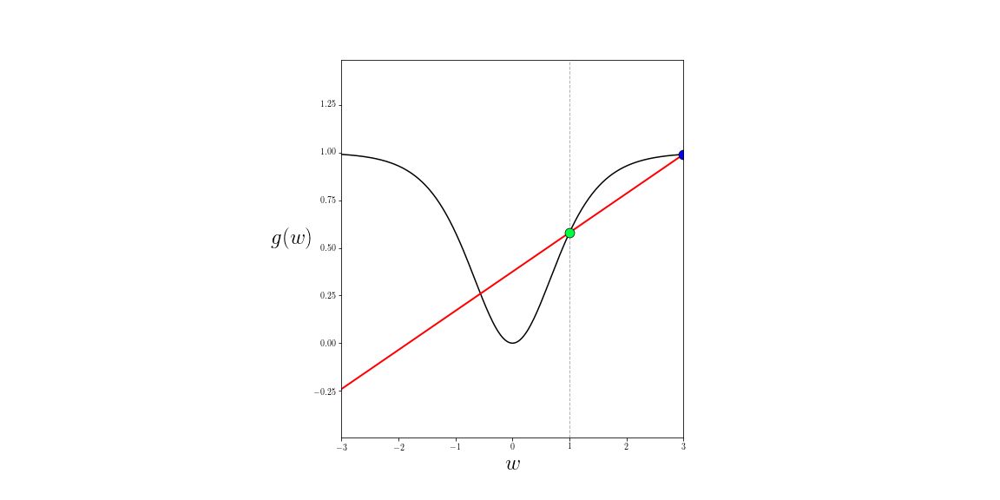

In [3]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.tanh(w)**2

# create an instance of the visualizer with this function
st = calclib.secant_to_tangent.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(w_init = 1, num_frames = 300)

#### <span style="color:#a50e3e;">Example 3. </span> An  example of failure: the rectified linear unit

Notice: that the slope of the secant line must smoothly change to the slope of the tangent line from **both** directions - from both the left and right - is important to this definition.  There are plenty of functions where this does not occur at every point, like the function

\begin{equation}
g(w) =  \text{max}(0,w)
\end{equation}

at the point $w^0 = 0$.  This function is called a *rectified linear unit* or *relu* for short.  Using the slider widget we can see that the slope of the secant line visibly jumps at this point.  Move the slider back and forth around where $w = 0$ and watch the slope of the secant jump distinctly from zero to one.  Because the slopes of the secant lines just to the left and right of the fixed point $w^0 = 0$ fail to line up, the function does not have a derivative here.  So try as you might, the line will never turn green.


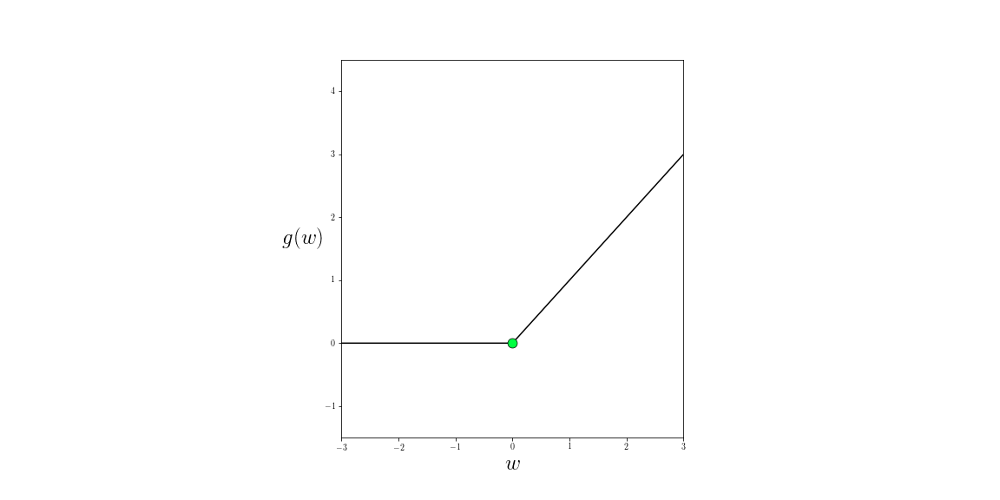
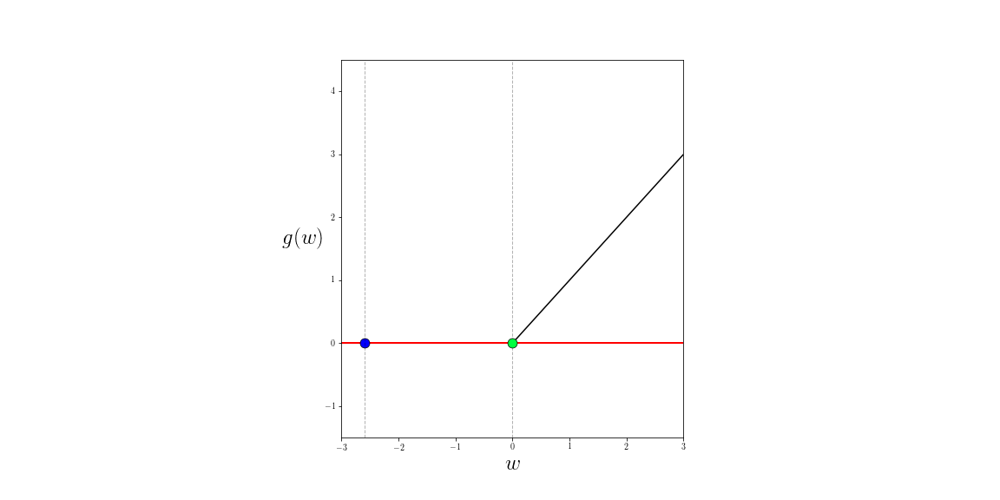
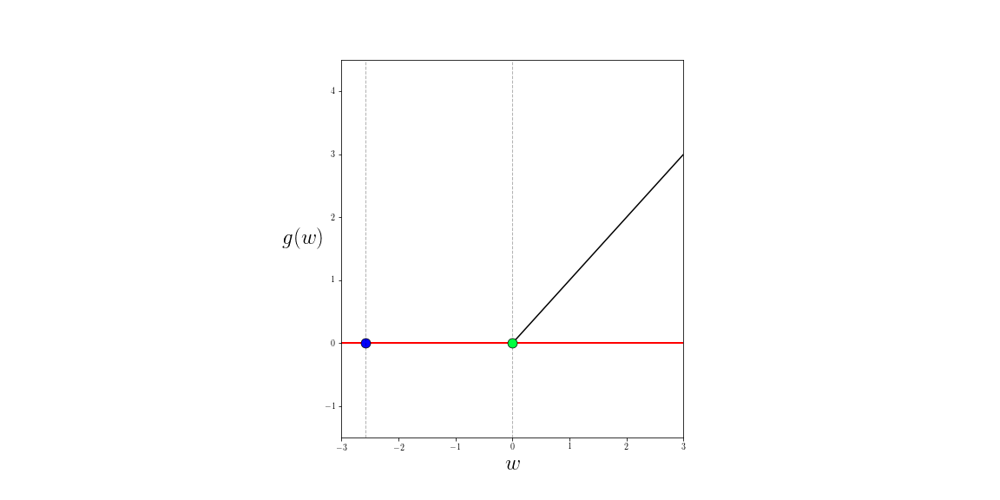
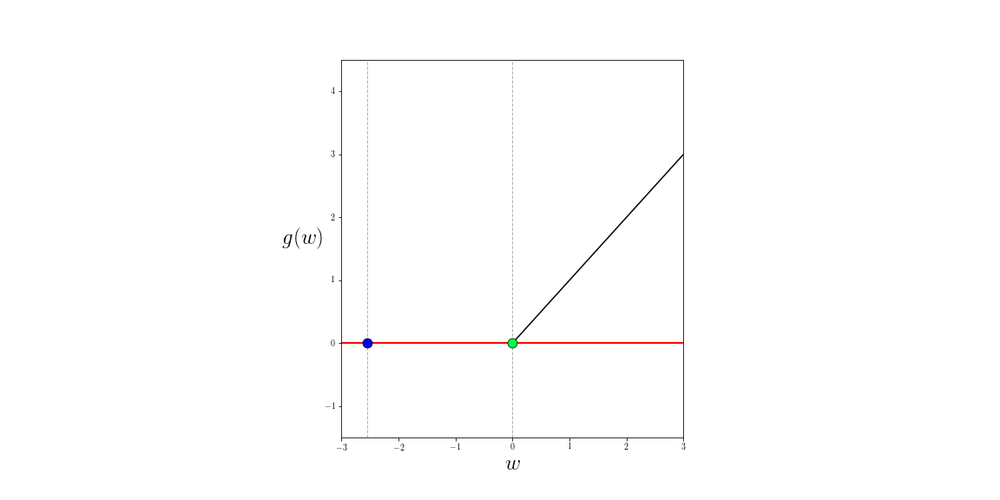
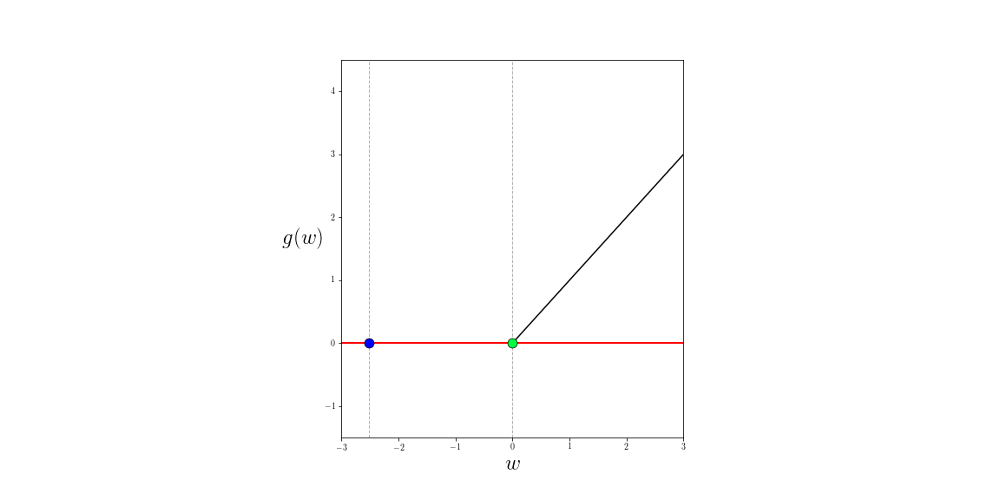
...
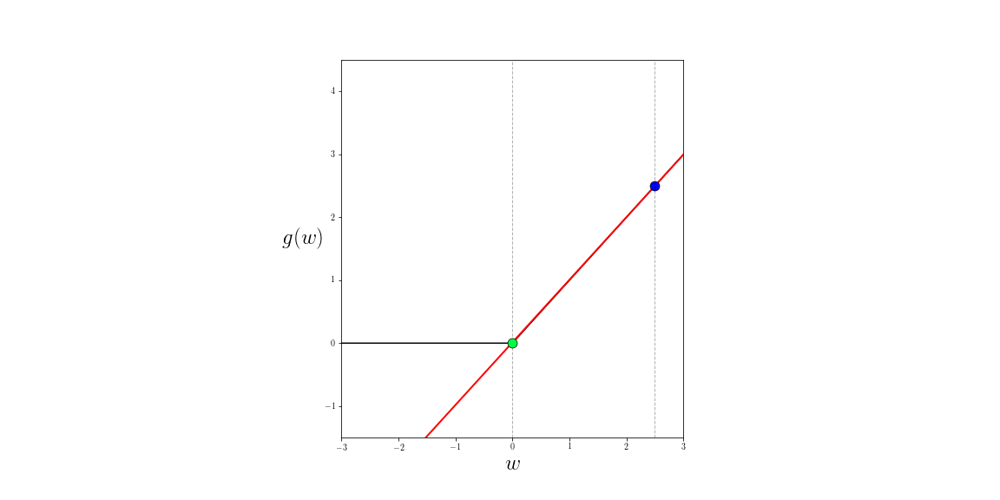
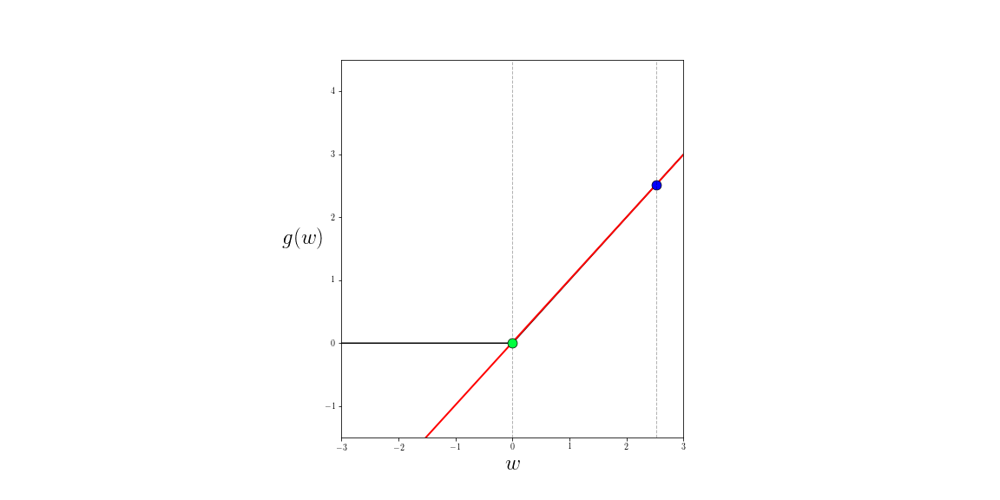
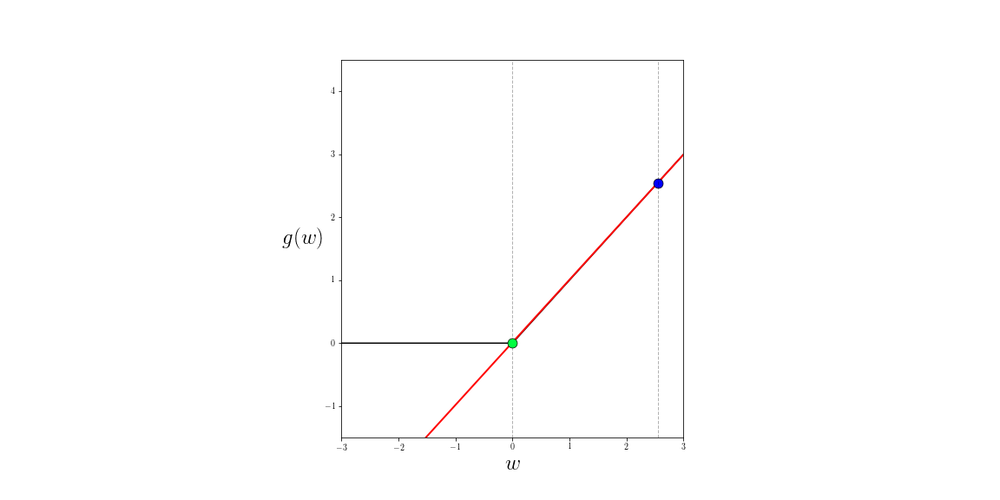
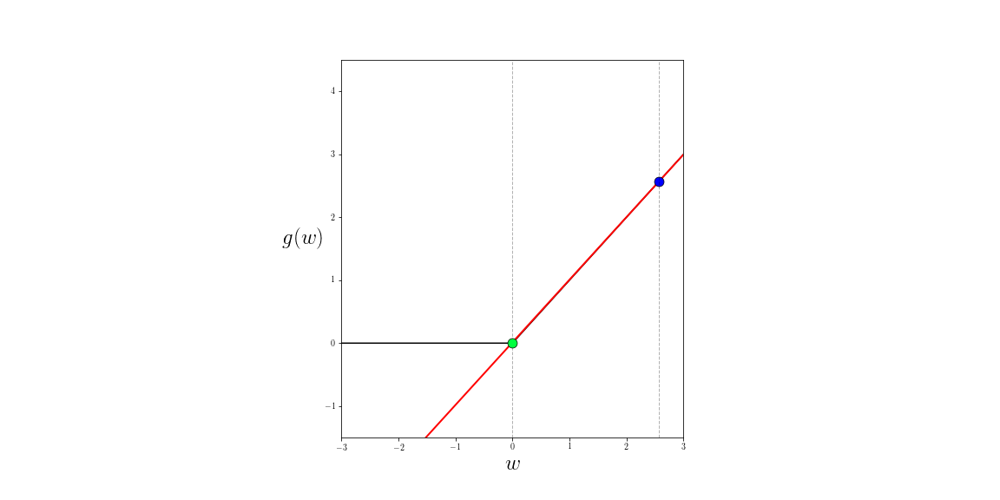
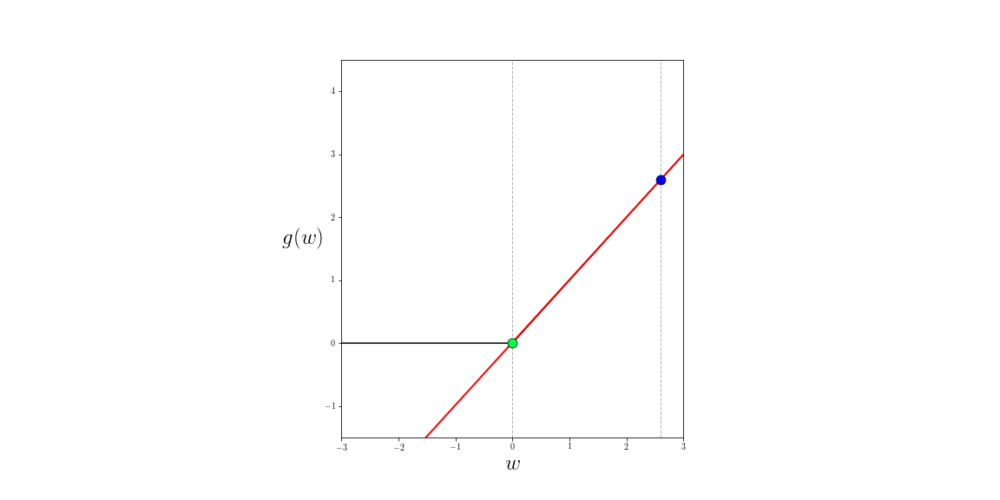

In [4]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.maximum(w,0)

# create an instance of the visualizer with this function
st = calclib.secant_to_tangent.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it(w_init = 0, num_frames = 200,mark_tangent = False)

## 2.2.3 From secant slope to derivative


With this in mind how can we compute the equation of a tangent line at some point $w^0$ for a given function?  More specifically, how can we compute the derivative here - or the slope of this tangent line?  Well we know that if we take another point $w_1$ on either side of $w^0$ and connect the two - creating the secant line with equation

\begin{equation}
h(w)  = g(w^0) +  \frac{g(w^1) - g(w^0)}{w^1 - w^0}(w - w^0)
\end{equation}

that as we push $w^1$ ever closer towards $w^0$ that this secant *becomes* our tangent line when $w^1 \approx w^0$.  Now note $w^1$ appears only in the slope of this equation, hence the slope of this line is the only quantity that changes as $w^1$ gets closer to $w^0$ and the secant line becomes tangent at $w^0$.  This is great because now in our aim to understand the tangent line we can focus our attention solely on what is happening with the slope of the secant - which is precisely the derivative (the slope of the tangent line) that we are after.  

Now, remember that the slope of a line measures its slope, or 'rise over run' which is the change in its vertical value ($g(w^1) - g(w^0)$) over the change in its horizontal value ($w^1 - w^0$).  In other words

\begin{equation}
\text{slope of secant line} = \frac{\text{change in $g$}}{\text{change in $w$}} = \frac{g(w^1) - g(w^0)}{w^1 - w^0}
\end{equation}

As $w^1$ inches ever closer to $w^0$ - from either the left or the right of $w^0$ - the change in both $g$ and $w$ becomes incredibly small or *infinitesimal*.  And this is how the derivative is conceptually defined: as the slope of a secant line where $w^1$ is so close to $w^0$ that the change in $g$ and $w$ are both *infinitesimal*.  And remember: the value of this slope needs to be the same whether or not $w^1$ lies to the left or right of $w^0$.  

> The derivative of a function $g$ at a point $w^0$ is the slope of the tangent line there, which in turn is the slope of a secant line where $w^1$ is so close to $w^0$ that the both the change in $g$ and $w$ defining the slope of the tangent are infinitesimal small.

## 2.2.4 Refining the definition of the derivative

Lets quantify more explicitly using math notation what this definition means, first by backing off the 'infinitesimally small' part for a moment - lets just make the difference very small.  We can define a generic point very *close to and to the right* of $w^0$ by denoting by $\epsilon$ some small positive number (e.g., $\epsilon = 0.0001$), then the point $w^1 = w^0 + \epsilon$ is indeed quite close to $w^0$.   Following, then the slope of the secant line connecting $(w^0,g(w^0))$ to $(w^0 + \epsilon, g(w^0 + \epsilon))$ is given as

\begin{equation}
\frac{g(w^1) - g(w^0)}{w^1 - w^0} = \frac{g(w^0 + \epsilon) - g(w^0)}{w^0 + \epsilon - w^0}
 =  \frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon}
\end{equation}

To ensure that this value is indeed close to the derivative value we need to check that the slope of this secant line is very similar to the slope of a secant based at $w_0$ and going through a point *slightly to the left* of $w^0$.  Taking the same value for $\epsilon$ we can take the point $w^0 - \epsilon$ which lies just to the left of $w^0$.  Forming the secant connecting points $(w^0, g(w^0))$ and $(w^0 - \epsilon, g(w^0 - \epsilon))$ we can compute its slope as

\begin{equation}
\frac{g(w^1) - g(w_0)}{w^1 - w^0} = \frac{g(w^0 - \epsilon) - g(w^0)}{w^0 - \epsilon - w^0}
 =  - \frac{g(w^0 - \epsilon) - g(w^0)}{\epsilon}
\end{equation}

If there is indeed a derivative at $w^0$ then the value of this slope needs to closely match the slope of our first secant, or in other words

\begin{equation}
 \frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon} \approx  - \frac{g(w^0 - \epsilon) - g(w^0)}{\epsilon}
\end{equation}

And - moreover - as we make $\epsilon$ smaller and smaller these two quantities should *both* settle down to one value, and be *perfectly equal* to each other.  

Notice that we can express this more compactly if we let $\epsilon$ represent a small (in magnitude) positive *or* negative number.  Then we can say equivalently that we desire that the quantity

\begin{equation}
 \frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon} 
\end{equation}

to settle down as we make $\epsilon$ smaller and smaller in magnitude.  We can still think about this more compact formula as representing the slope of secant lines on either side of $w^0$, getting ever closer on both sides to $w^0$ we make the magnitude of $\epsilon$ infinitesimally small.  

Writing this algebraically we say that we want the value $ \frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon} $ to converge to a single value as  $\vert\epsilon\vert \longrightarrow 0$.

### Common notations for the derivative

One common notation used to denote this ratio of infinitesimal changes $\frac{\text{infinitesimal change in $g$}}{\text{infinitesimal change in $w$}}$ is  $\frac{\mathrm{d}g}{\mathrm{d}w}$.  Here the symbol $\mathrm{d}$ means 'infinitely small change in the value of'.  A common variation on this notation puts the $g$ out front, like this $ \frac{\mathrm{d}}{\mathrm{d}w}g$.  In short - we have both the definition and symbol to denote a general derivative of $g$ at any point as

\begin{equation}
\text{derivative} = \frac{\text{infinitesimal change in $g$}}{\text{infinitesimal change in $w$}}:= \frac{\mathrm{d}g}{\mathrm{d}w} \,\,\, \text{or} \,\,\, \frac{\mathrm{d}}{\mathrm{d}w}g
\end{equation}

There are other notations commonly used in practice to denote the derivative, but we will stick to using these.

To denote the derivative at a specific point $w^0$ we will write

\begin{equation}
\frac{\mathrm{d}}{\mathrm{d}w}g(w^0)
\end{equation}

#### <span style="color:#a50e3e;">Example 4. </span> Computing approximate derivatives at a point

Take our sinusoid, the point $w^0 = 0$, and a small magnitude value for $\epsilon$ like $\epsilon = 0.0001$.  Computing the slope of a secant line where $w^1 = w^0 + \epsilon$ lies just to the right of $w^0$ we have

\begin{equation}
\frac{g(w_0 + \epsilon) - g(w_0)}{\epsilon} = \frac{\text{sin}(0.0001)}{0.0001}\approx 0.99999
\end{equation}

Likewise computing the slope of the secant line where $w^1 = w^0 - \epsilon$ lies just to the left of $w^0$ we have

\begin{equation}
-\frac{g(w^0 - \epsilon) - g(w^0)}{\epsilon} = -\frac{\text{sin}(-0.0001)}{0.0001}\approx 0.99999
\end{equation}

Indeed both slopes are approximately equal, so we can definitively say at $w^0 = 0$ 

\begin{equation}
\frac{\mathrm{d}}{\mathrm{d}w}g(w^0) \approx 0.99999 
\end{equation}

Using this we can write out the equation of the tangent line to the sinusoid at $w^0 = 0$ as 

\begin{equation}
h(w) = \text{sin}(0) + 0.9999(w - 0) = 0.9999w
\end{equation}

#### <span style="color:#a50e3e;">Example 5. </span> Checking non-differentiability at $w = 0$ for the relu function

Checking differentiability of the relu function

\begin{equation}
g(w) =  \text{max}(0,w) 
\end{equation}

at $w^0 = 0$ we have that the slope of a secant where $w^1 = w^0 + \epsilon$ for any small $\epsilon > 0$ (e.g.,$\epsilon = 0.0001$) coming from the right

\begin{equation}
\frac{g(w^0 + \epsilon) - g(w^0)}{\epsilon} = \frac{\text{max}(0,0.0001)}{0.0001}= \frac{0.0001}{0.0001} = 1
\end{equation}

A similar computation where $w^1 = w^0 - \epsilon$ comes in from the left gives

\begin{equation}
-\frac{g(w^0 - \epsilon) - g(w^0)}{\epsilon} = -\frac{\text{max}(0,-0.0001)}{0.0001}= -\frac{0}{0.0001} = 0
\end{equation}

Since these two secant slopes do not match up, the function is not differentiable at $w^0 = 0$, and these computations hold regardless of the magnitude of $\epsilon$.

## 2.2.5 Our first derivative calculator: the Numerical Differentiation

In this short Subsection we briefly discuss our first of several methods for calculating derivatives programatically (or, in other words, coding up a derivative calculator): the Numerical Differentiator.   To create this calculator we just code up the the definition of the derivaitve at a point discussed in the previous section.

The most straightforward way to build a derivative calculator is to just use the definition of the derivative at a point given above, and used extensively in examples in the previous Section.  That is, for small (magnitude) $\epsilon$ the value the derivative of a function $g(w)$ is approximately

\begin{equation}
 \frac{\mathrm{d}}{\mathrm{d}w}g(w) \approx \frac{ g(w + \epsilon) - g(w)}{\epsilon} 
\end{equation}

So if we want to make a program that estimates the derivative of some function at a point, why not simply choose a small positive value for $\epsilon$, approximate every derivative we encounter simply as 

$$
\frac{ g(w + \epsilon) - g(w)}{\epsilon} 
$$

and call it a day?  This would clearly be extremely easy to code up - a (more or less) one line derivative calculator. 

In the next Python cell we provide a Python class that simply implements the above numerical definition of the derivative for a user-defined choice of $\epsilon$.  Those wanting a good introduction to Python classes, in particular for implementing mathematical functions and objects, can see e.g., [this excellent book](http://hplgit.github.io/primer.html/doc/pub/class/class-readable.html).

In [5]:
class numerical_derivative:
    '''
    A function for computing the numerical derivative
    of an arbitrary input function and user-chosen epsilon
    '''
    def __init__(self, g):
        # load in function to differentiate
        self.g = g; self.epsilon = 10*-5

    def __call__(self, w,**kwargs):
        # make local copies 
        g, epsilon = self.g, self.epsilon 
        
        # set epsilon to desired value or use default
        if 'epsilon' in kwargs:
            epsilon = kwargs['epsilon']
        
        # compute derivative approximation and return
        approx = (g(w+epsilon) - g(w))/epsilon
        return approx

While the functionality is very simple we will see the examples here that it can be difficult in practice to set the value of $\epsilon$ correctly.

#### <span style="color:#a50e3e;">Example 6. </span>  A simple sinusoid

Lets check that this function will indeed compute accurate derivatives for a simple function whose derivatives we can visually verify are correct / incorrect

\begin{equation}
g(w) = \text{sin}(w)
\end{equation}

This elementary function actually has an *algebraic formula* for its derivative - as we will see in the next Section - which is given by $\frac{\mathrm{d}}{\mathrm{d}w}g(w) = \text{cos}(w)$.  

In the next Python cell we run a fine grid of points on the interval [-5,5] through our Numerical Differentiator and plot the result - along with the original function.

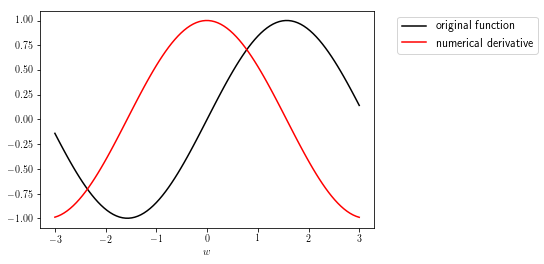

In [6]:
# make function, create derivative
g = lambda w: np.sin(w)
der = numerical_derivative(g)

# evaluate the derivative over this range of input
wvals = np.linspace(-3,3,100)
gvals = [g(w) for w in wvals]
dervals = [der(w,epsilon = 10**-2) for w in wvals]

# plot function and derivative
plt.plot(wvals,gvals,color = 'k',label = 'original function')
plt.plot(wvals,dervals,color = 'r',label = 'numerical derivative') 
plt.legend(bbox_to_anchor=(1.05, 1), loc=2,fontsize = 12); plt.xlabel('$w$')
plt.show()

Looks good!  Here we used the particular value of $\epsilon = 10^{-2}$.  Lets see what happens to our numerical derivative as we adjust the value of $\epsilon$.

In the next Python cell we use a widget to animate a wide selection of values for $\epsilon$ from $1$ to $10^{-17}$.  In each slide the function is plotted in black, the true derivative in dashed blue, and the numerical derivative with chosen value of $\epsilon$ (printed on the title of each slide) is shown in red.  As you move the slider from left to right the value of $\epsilon$ becomes exponentially smaller.


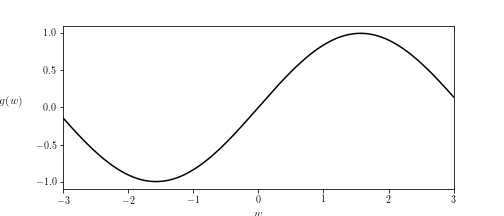
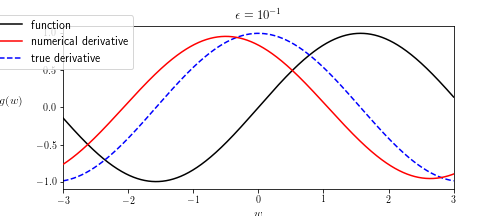
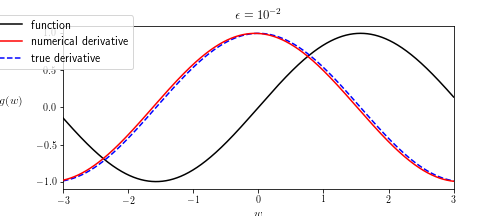
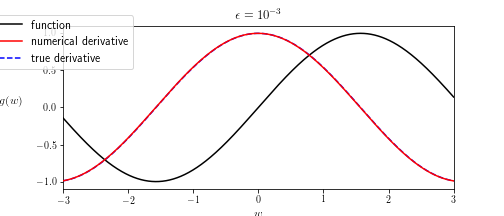
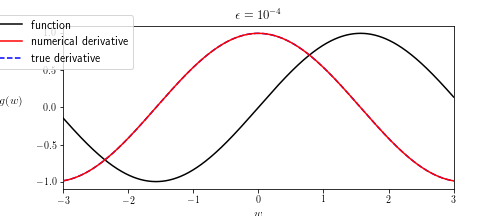
...
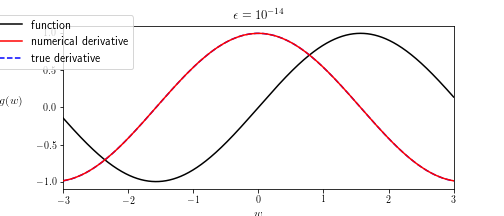
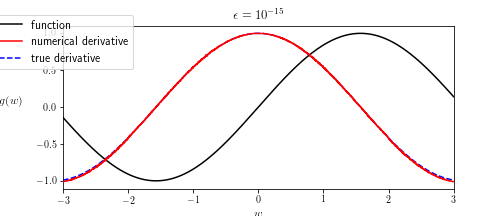
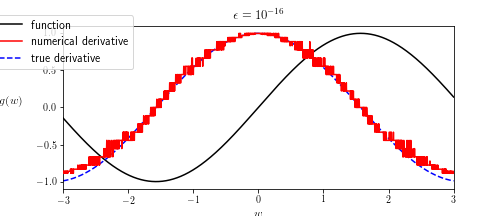
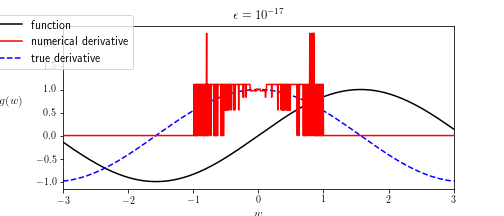
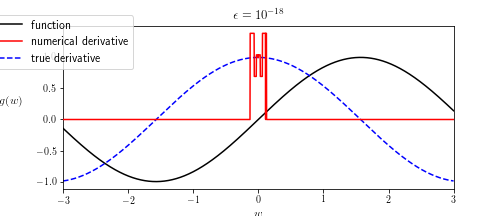

In [7]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.sin(w)

# create an instance of the visualizer with this function
st = calclib.numder_silder.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it()

By playing around with the slider you can see that by around $\epsilon = 10^{-3}$ the numerical approximation of the derivative is virtually perfect.  So a value for $\epsilon$ at least this small would work perfectly fine for this example.  

Notice, however, that not every value smaller than $10^{-3}$ is a good option.  When $\epsilon = 10^{-16}$ and smaller things start to look bad, the numerical derivative becomes terrible and by $10^{-18}$ it is zero in many places.

There in lies the rub: we need to set $\epsilon$ small for the approximation to theoretically be close to the actual derivative value, but set $\epsilon$ too small creates a second problem called *round-off error*.  Numerical values - whether or not they are produced from a mathematical function - can only be represented up to a certain accuracy on a computer.  In particular, we always have a tough time representing fractional numbers $\frac{a}{b}$ where both $a$ and $b$ are close to zero.  But - as we make $\epsilon$ small - this is precisely what becomes of the approximation

$$
\frac{ g(w + \epsilon) - g(w)}{\epsilon} 
$$

since both the top (since the values $g(w + \epsilon)$ and $g(w)$ become essentially identical)  and bottom of this fraction become incredibly small as we shrink the value of $\epsilon$. 

----

#### <span style="color:#a50e3e;">Example 7.</span> A rapidly changing approximation to the derivative 

Take for example the function 

\begin{equation}
g(w) = \frac{\text{cos}(40w)^{100}}{w^2 + 1}
\end{equation}

printed out by the next Python cell.  In this cell we use a widget that animates a wide selection of values for $\epsilon$ from $1$ to $10^{-17}$.  In each slide the function is plotted in black, the true derivative in dashed blue, and the numerical derivative with chosen value of $\epsilon$ (printed on the title of each slide) is shown in red.


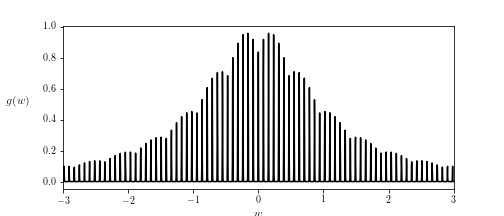
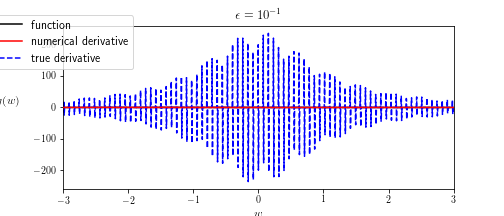
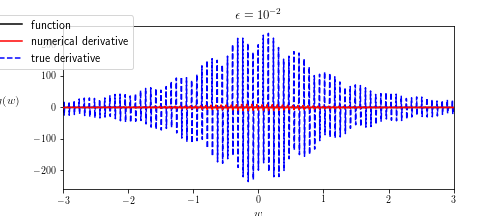
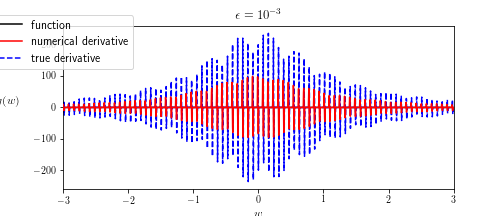
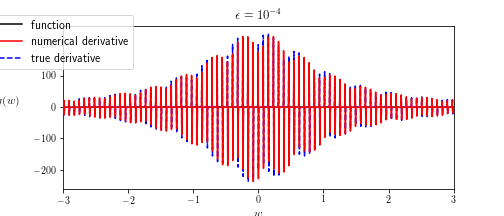
...
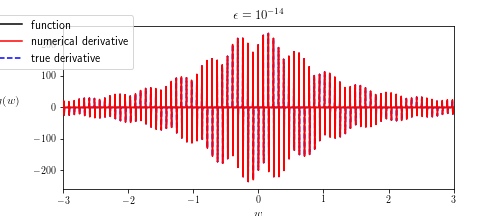
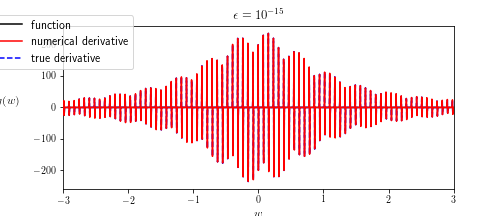
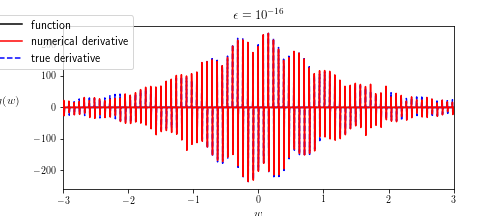
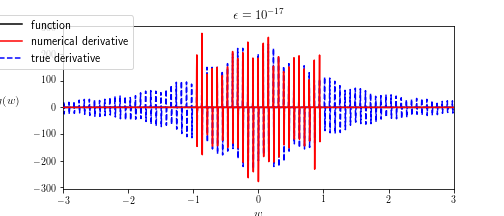
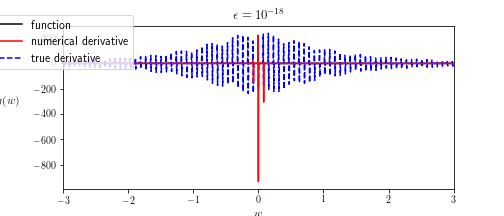

In [8]:
# what function should we play with?  Defined in the next line, along with our fixed point where we show tangency.
g = lambda w: np.cos(40*w)**100/(w**2 + 1)

# create an instance of the visualizer with this function
st = calclib.numder_silder.visualizer(g = g)

# run the visualizer for our chosen input function and initial point
st.draw_it()

As compared to the first example, here we need to set $\epsilon$ considerably smaller - to around $10^{-6}$ - in order for the numerical derivative to approximate the true derivative well.  Once again pushing the slider all the way to the right - making $\epsilon$ very small - also results in a poor approximation due to round-off error.

&copy; This material is not to be distributed, copied, or reused without written permission from the authors.